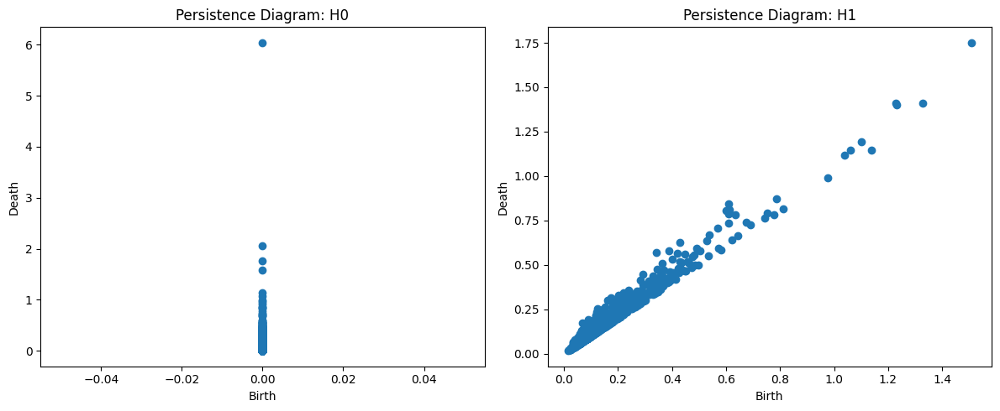

In [1]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from ripser import ripser
import matplotlib.pyplot as plt
import numpy as np

# Load dataset
df = pd.read_csv('processed_nuforc_full.csv')

# Selecting numeric features (adjust as needed)
features = df.select_dtypes(include=['float64', 'int64']).dropna()

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(features)

# Apply PCA to reduce dimensions
pca = PCA(n_components=3)
data_pca = pca.fit_transform(data_scaled)

# Downsample to avoid memory issues
sample_size = 5000  # Adjust this number based on your system's capacity
indices = np.random.choice(data_pca.shape[0], sample_size, replace=False)
data_sampled = data_pca[indices]

# Compute persistent homology on the downsampled data
ph_result = ripser(data_sampled, maxdim=1)['dgms']

# Plot persistence diagrams for dimensions 0 and 1
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title('Persistence Diagram: H0')
plt.scatter(ph_result[0][:, 0], ph_result[0][:, 1])
plt.xlabel('Birth')
plt.ylabel('Death')

plt.subplot(1, 2, 2)
plt.title('Persistence Diagram: H1')
plt.scatter(ph_result[1][:, 0], ph_result[1][:, 1])
plt.xlabel('Birth')
plt.ylabel('Death')

plt.tight_layout()
plt.show()


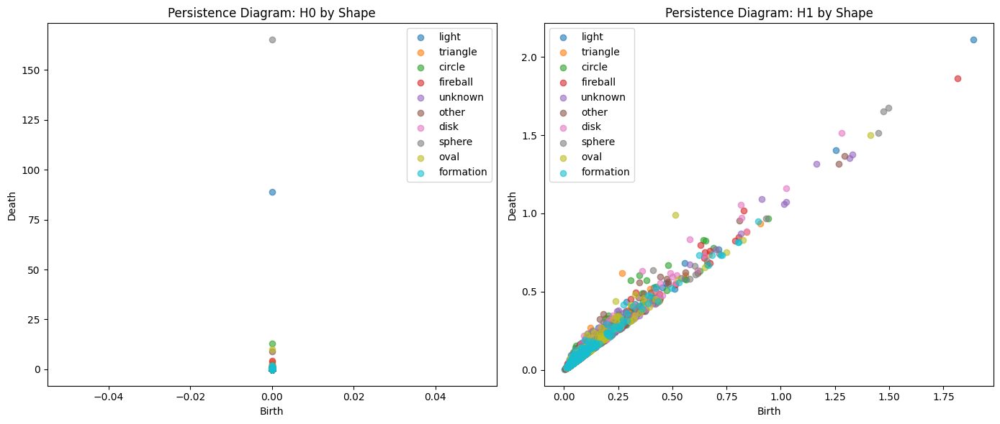

In [6]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from ripser import ripser
import matplotlib.pyplot as plt

# Load dataset
df = pd.read_csv('processed_nuforc_full.csv')

# Selecting numeric features (adjust as needed) and drop rows with missing numeric data
features = df.select_dtypes(include=['float64', 'int64']).dropna()

# Align the dataframe with the cleaned features (assumes that features.index is the subset of df's index)
df_clean = df.loc[features.index]

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(features)

# Apply PCA to reduce dimensions
pca = PCA(n_components=3)
data_pca = pca.fit_transform(data_scaled)

# Create a DataFrame of the PCA results and include the 'shape' column for coloring
df_pca = pd.DataFrame(data_pca, columns=['PC1', 'PC2', 'PC3'])
df_pca['shape'] = df_clean['shape'].values  # use the cleaned df

# Identify the top 5 most frequent shapes
top_shapes = df_pca['shape'].value_counts().head(10).index.tolist()

# Create a color mapping for these top shapes using a colormap
colors = plt.cm.tab10(np.linspace(0, 1, len(top_shapes)))
color_dict = dict(zip(top_shapes, colors))

# For each top shape, compute persistence diagrams (H0 and H1)
pers_dgms = {}  # dictionary: key = shape, value = dict with keys 'H0' and 'H1'
sample_size_max = 2000  # maximum points per shape to use in persistence computation

for shape in top_shapes:
    # Subset data for the current shape
    subset = df_pca[df_pca['shape'] == shape]
    data_shape = subset[['PC1', 'PC2', 'PC3']].values
    # Downsample if necessary
    if data_shape.shape[0] > sample_size_max:
        indices = np.random.choice(data_shape.shape[0], sample_size_max, replace=False)
        data_shape = data_shape[indices]
    # Compute persistent homology for this shape (maxdim=1 gives H0 and H1)
    dgms = ripser(data_shape, maxdim=1)['dgms']
    pers_dgms[shape] = {'H0': dgms[0], 'H1': dgms[1]}

# Plot the persistence diagrams for H0 and H1, overlaid by shape
plt.figure(figsize=(14, 6))

# Persistence diagram for H0
plt.subplot(1, 2, 1)
plt.title('Persistence Diagram: H0 by Shape')
for shape in top_shapes:
    dgm = pers_dgms[shape]['H0']
    plt.scatter(dgm[:, 0], dgm[:, 1],
                label=shape,
                color=color_dict[shape],
                alpha=0.6)
plt.xlabel('Birth')
plt.ylabel('Death')
plt.legend()

# Persistence diagram for H1
plt.subplot(1, 2, 2)
plt.title('Persistence Diagram: H1 by Shape')
for shape in top_shapes:
    dgm = pers_dgms[shape]['H1']
    plt.scatter(dgm[:, 0], dgm[:, 1],
                label=shape,
                color=color_dict[shape],
                alpha=0.6)
plt.xlabel('Birth')
plt.ylabel('Death')
plt.legend()

plt.tight_layout()
plt.show()


PCA Loadings:
                         PC1       PC2       PC3
duration (seconds) -0.006761 -0.117539  0.971293
latitude            0.698254 -0.104110  0.009950
longitude          -0.698244  0.100407  0.006040
timestamp           0.142808  0.650080 -0.078033
shape_encoded       0.066751  0.736655  0.224422


C:\Users\bobov\AppData\Local\Temp\ipykernel_11060\905064166.py:27: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



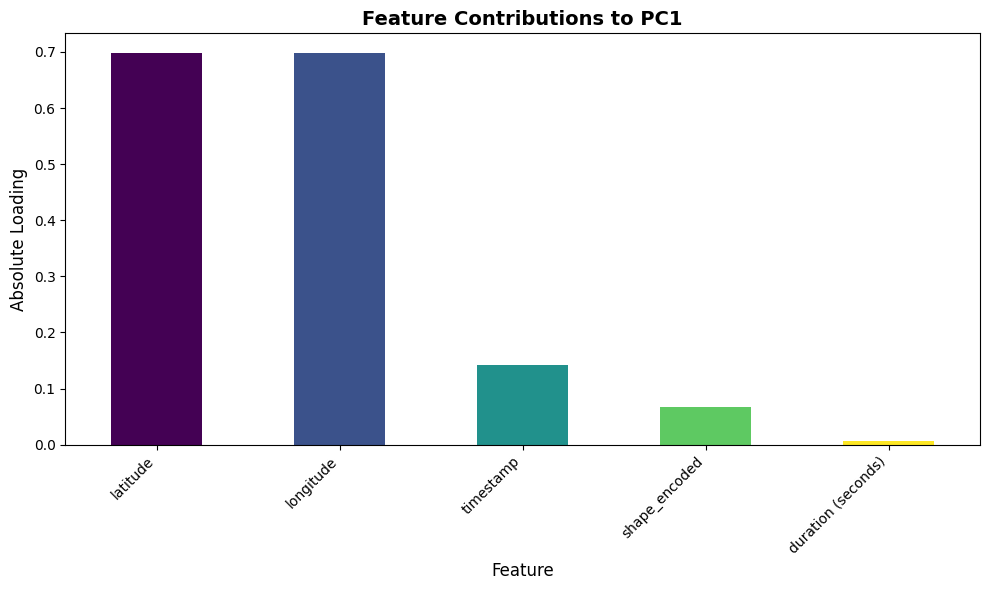

C:\Users\bobov\AppData\Local\Temp\ipykernel_11060\905064166.py:27: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



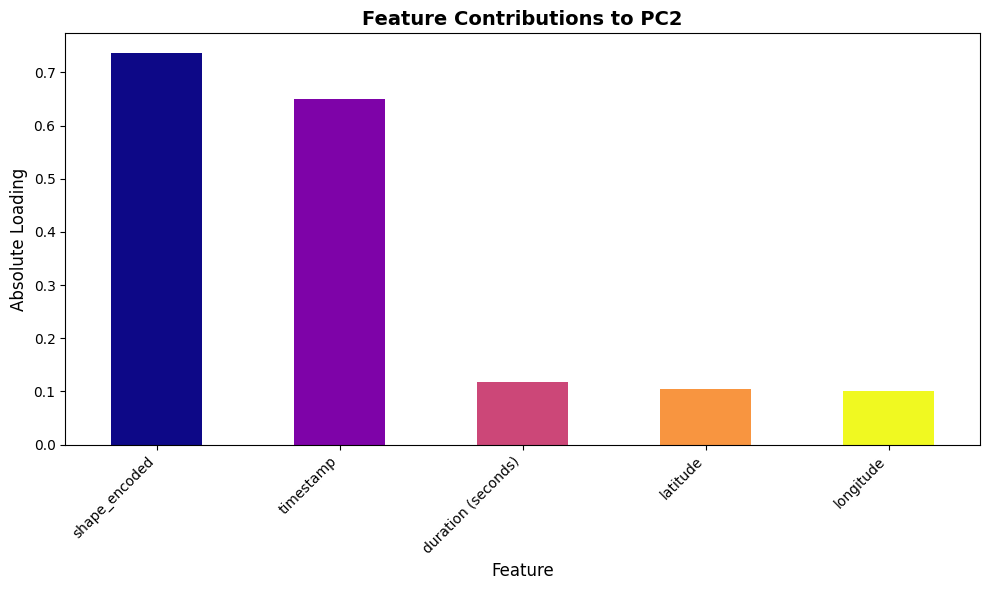

C:\Users\bobov\AppData\Local\Temp\ipykernel_11060\905064166.py:27: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



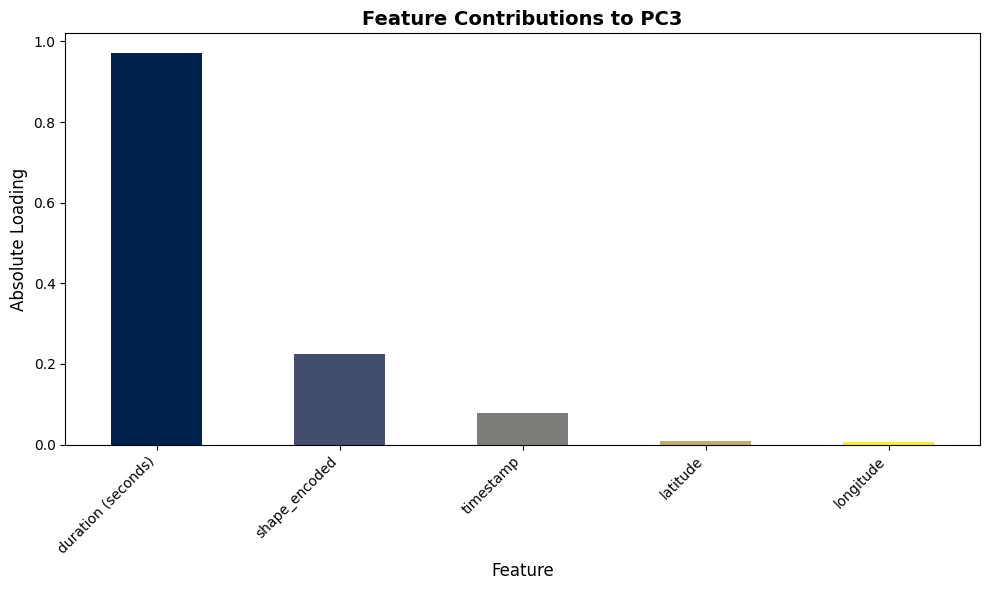

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np



# Assuming 'features' is your DataFrame of original numeric features
# and 'pca' is your fitted PCA model
loadings = pd.DataFrame(
    pca.components_.T, 
    columns=[f'PC{i+1}' for i in range(pca.n_components_)],
    index=features.columns
)

print("PCA Loadings:")
print(loadings)

def plot_pc_contributions(pc_name, cmap='viridis'):
    """
    Plots the absolute value of loadings for a given principal component (pc_name)
    using a color gradient from the chosen colormap.
    """
    # Sort features by their absolute loadings for this PC
    data = loadings[pc_name].abs().sort_values(ascending=False)
    
    # Create a color gradient
    colors = plt.cm.get_cmap(cmap)(np.linspace(0, 1, len(data)))
    
    # Plot
    plt.figure(figsize=(10, 6))
    data.plot(kind='bar', color=colors)
    plt.title(f'Feature Contributions to {pc_name}', fontsize=14, fontweight='bold')
    plt.ylabel('Absolute Loading', fontsize=12)
    plt.xlabel('Feature', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

# Plot for PC1, PC2, PC3 (adjust if you have more or fewer components)
plot_pc_contributions('PC1', cmap='viridis')
plot_pc_contributions('PC2', cmap='plasma')
plot_pc_contributions('PC3', cmap='cividis')


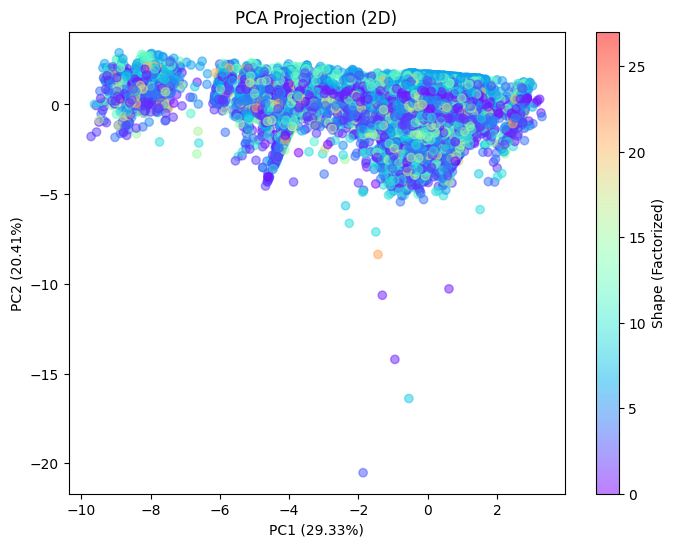

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

# Factorize the shape column into numeric labels
shape_labels, shape_categories = pd.factorize(df['shape'])

# Extract the explained variance ratio from the PCA object
explained_variance = pca.explained_variance_ratio_

# Create readable labels for the axes:
pc1_label = f"PC1 ({explained_variance[0]*100:.2f}%)"
pc2_label = f"PC2 ({explained_variance[1]*100:.2f}%)"

plt.figure(figsize=(8, 6))

# Color points by shape, using the factorized labels
scatter = plt.scatter(
    data_pca[:, 0], 
    data_pca[:, 1], 
    c=shape_labels, 
    cmap='rainbow',   # or any other colormap you like
    alpha=0.5
)

plt.xlabel(pc1_label)
plt.ylabel(pc2_label)
plt.title('PCA Projection (2D)')

# Create a colorbar and label it
cbar = plt.colorbar(scatter)
cbar.set_label('Shape (Factorized)')

plt.show()


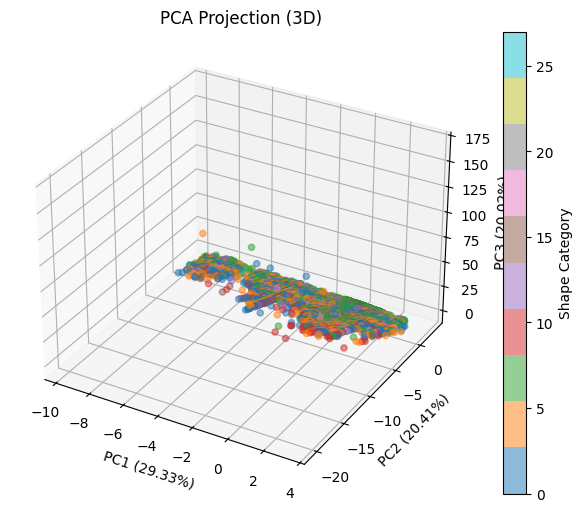

In [4]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Needed for 3D projection
import pandas as pd

# Factorize the 'shape' column to get numerical labels
shape_labels, shape_categories = pd.factorize(df['shape'])

# Get the explained variance for each principal component
explained_variance = pca.explained_variance_ratio_
pc1_label = f"PC1 ({explained_variance[0]*100:.2f}%)"
pc2_label = f"PC2 ({explained_variance[1]*100:.2f}%)"
pc3_label = f"PC3 ({explained_variance[2]*100:.2f}%)"

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot the 3D PCA projection colored by shape
scatter = ax.scatter(
    data_pca[:, 0],
    data_pca[:, 1],
    data_pca[:, 2],
    c=shape_labels,
    cmap='tab10',
    alpha=0.5
)

# Add a colorbar with a label
plt.colorbar(scatter, ax=ax, label='Shape Category')

# Label the axes with the principal component names and explained variance
ax.set_xlabel(pc1_label)
ax.set_ylabel(pc2_label)
ax.set_zlabel(pc3_label)
ax.set_title('PCA Projection (3D)')

plt.show()


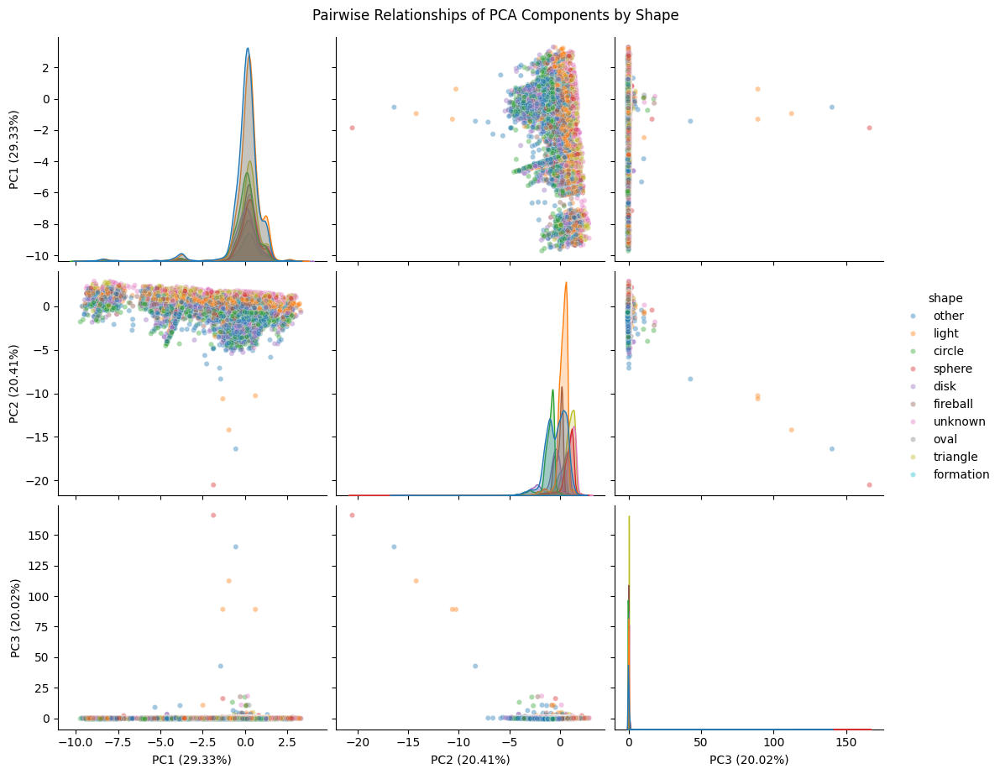

In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Suppose we have pca fitted; get explained variance
pc1_var = pca.explained_variance_ratio_[0] * 100
pc2_var = pca.explained_variance_ratio_[1] * 100
pc3_var = pca.explained_variance_ratio_[2] * 100

# Build df_pca with axis labels showing explained variance
df_pca = pd.DataFrame(data_pca, columns=[
    f"PC1 ({pc1_var:.2f}%)",
    f"PC2 ({pc2_var:.2f}%)",
    f"PC3 ({pc3_var:.2f}%)"
])
df_pca['shape'] = df['shape'].values

# Optionally limit to top 5 shapes + 'other'
top_shapes = df_pca['shape'].value_counts().nlargest(10).index
df_pca.loc[~df_pca['shape'].isin(top_shapes), 'shape'] = 'other'

# Custom palette for up to 6 categories (5 shapes + other)
palette = sns.color_palette('tab10', n_colors=10)

# Create the pairplot
g = sns.pairplot(
    df_pca,
    hue='shape',
    diag_kind='kde',
    palette=palette,
    plot_kws={'alpha': 0.4, 's': 20},
    height=3,
    aspect=1.2
)

g.fig.suptitle('Pairwise Relationships of PCA Components by Shape', y=1.02)
plt.show()


In [19]:
import pandas as pd
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Load dataset
df = pd.read_csv('processed_nuforc_full.csv')

# Selecting numeric features (adjust as needed)
features = df.select_dtypes(include=['float64', 'int64']).dropna()

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(features)

# Apply PCA to reduce dimensions
pca = PCA(n_components=3)
data_pca = pca.fit_transform(data_scaled)

# Prepare axis labels with explained variance percentages
pc1_var = pca.explained_variance_ratio_[0] * 100
pc2_var = pca.explained_variance_ratio_[1] * 100
pc3_var = pca.explained_variance_ratio_[2] * 100

pc1_label = f"PC1 ({pc1_var:.2f}%)"
pc2_label = f"PC2 ({pc2_var:.2f}%)"
pc3_label = f"PC3 ({pc3_var:.2f}%)"

# Create a DataFrame of the PCA results with descriptive column names
df_pca = pd.DataFrame(data_pca, columns=[pc1_label, pc2_label, pc3_label])

# Include the 'shape' column for coloring
df_pca['shape'] = df['shape'].values

# Limit to the top 10 shapes + 'other'
top_shapes = df_pca['shape'].value_counts().nlargest(10).index
df_pca.loc[~df_pca['shape'].isin(top_shapes), 'shape'] = 'other'

# Create an interactive scatter matrix with diagonal plots
fig = px.scatter_matrix(
    df_pca,
    dimensions=[pc1_label, pc2_label, pc3_label],
    color="shape",
    title="Pairwise Relationships of PCA Components by Shape",
    labels={"shape": "Shape"}
)

# Optionally save to HTML
fig.write_html("pairplot_interactive.html")

# Display the interactive plot
fig.show()


In [13]:
import pandas as pd
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Load dataset
df = pd.read_csv('processed_nuforc_full.csv')

# Selecting numeric features (adjust as needed)
features = df.select_dtypes(include=['float64', 'int64']).dropna()

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(features)

# Apply PCA to reduce dimensions
pca = PCA(n_components=3)
data_pca = pca.fit_transform(data_scaled)

# Create a DataFrame of the PCA results with plain column names,
# and include the 'shape' column for coloring
df_pca = pd.DataFrame(data_pca, columns=['PC1', 'PC2', 'PC3'])
df_pca['shape'] = df['shape'].values  # Assumes 'shape' column exists in df

# Prepare axis labels with explained variance percentages
pc1_label = f"PC1 ({pca.explained_variance_ratio_[0]*100:.2f}%)"
pc2_label = f"PC2 ({pca.explained_variance_ratio_[1]*100:.2f}%)"
pc3_label = f"PC3 ({pca.explained_variance_ratio_[2]*100:.2f}%)"

# Create the interactive 3D scatter plot using Plotly Express
fig = px.scatter_3d(
    df_pca,
    x='PC1',
    y='PC2',
    z='PC3',
    color='shape',  # Color by the shape column
    opacity=0.7,
    labels={
        "PC1": pc1_label,
        "PC2": pc2_label,
        "PC3": pc3_label,
        "shape": "Shape"
    }
)

fig.update_layout(title='3D PCA Projection (Interactive)')
fig.show()
fig.write_html('pca_3d_plot.html')
